<a href="https://colab.research.google.com/github/cayleighhaag10/CayleighWebsiteFirstTry/blob/main/Deploy_Model_on_Images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Demonstration of model on N images.

In this notebook, we will demonstrate the model's detection and evalutation, including post-processing, for a small subset of images, the number of which will be inputted by the user below, and (optionally) for a specific year (see'Detection').

In [159]:
# We will install the required libraries.
!pip install numpy pandas matplotlib opencv-python torch torchvision ultralytics==8.4.7

# We will also clone our GitHub Repository (first removing the previously cloned repository).
!rm -rf /content/DeployModelOnImages
!git clone https://github.com/cayleighhaag10/DeployModelOnImages.git

Cloning into 'DeployModelOnImages'...
remote: Enumerating objects: 61585, done.
remote: Counting objects: 100% (322/322), done.
remote: Compressing objects: 100% (317/317), done.
remote: Total 61585 (delta 19), reused 287 (delta 5), pack-reused 61263 (from 2)
Receiving objects: 100% (61585/61585), 902.41 MiB | 45.37 MiB/s, done.
Resolving deltas: 100% (56/56), done.


In [160]:
# Import the necessary libraries.
from ultralytics import YOLO
import os
import glob
import pandas as pd
import shutil
import json
import geopandas as gpd
from shapely import wkt
import random
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from scipy.optimize import linear_sum_assignment
import numpy as np

# Image Selection

We will use pre-computed weights to detect aqaducts for our image sampling.

---


The following code will load the pre-comupted weights that we will use for detection. It will also load  the images that we will run detection and evaluation for.

In [161]:
# Load data.
weights = "/content/DeployModelOnImages/weights_final.pt"
model = YOLO(weights)

# Load images.
folder = '/content/DeployModelOnImages/images_for_detection'

Please supply the number images you would like to run detection on. This number should be between 1 - 100. Please also input the year you would like to run detection on (correct inputs are are '1974', '1982', '1984', or '2019'). If you would like to deploy the model on images from a random sample of the years, input '0'.

In [162]:
# USER PROVIDED INPUTS
# Correct inputs are integers, from 1 to 100.
num_images = 80
# Correct inputs are integers, either 0, 1974, 1982, 1984, or 2019.
user_provided_year = 1982

In [163]:
# If the user input for number of images is too large, set to a default value.
if (num_images <= 0 or num_images > 100):
  num_images = 10

# This will contain random sample of num_images images, from a specified year.
image_paths = []
if (user_provided_year == 1974 or user_provided_year == 1982 or user_provided_year == 1984 or user_provided_year == 2019):
  # Get all images whose prefix is a certain year.
  all_images = [
    os.path.join(folder, f)
    for f in os.listdir(folder)
    if os.path.isfile(os.path.join(folder, f)) and f[1:].startswith(str(user_provided_year))]

  # Take a random sample of those images of size num_images.
  image_paths = random.sample(all_images, num_images)

else: # Default case.
  # Get all images.
  all_images = [os.path.join(folder, f) for f in os.listdir(folder)]

  # Take a random sample of those images of size num_images.
  image_paths = random.sample(all_images, num_images)

# Pre-Processing

Before we preform detection, we will rescale all of our images to be 256 x 256 pixels. Due to different resolutions, these images may initally be different sizes.

In [164]:
for path in image_paths:
    # Open the image.
    img = Image.open(path)
    # Resize to 256x256.
    img_resized = img.resize((256, 256))

    # Save back to the same path (overwriting original).
    img_resized.save(path)

# Detection

We will run this model on our images, which we will sample randomly according to user inputs (num_images and year). We will also display the results.

['/content/DeployModelOnImages/images_for_detection/H1982_13866_jpg.rf.b8c331b67fe4a0545e21f17641fdd671.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_10775_jpg.rf.d98e2cfd88aab982ff2ff4712377a377.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_11765_jpg.rf.481f949b69ad1f25d120a8cf7b6cbd72.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_5950_jpg.rf.300e836e213acf4769321045a8e28e00.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_10773_jpg.rf.b2ef2fd5c97f3100b4462269cfe6cf10.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_3791_jpg.rf.8a554bc613bc2d30c9a22d18fe2122fc.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_6812_jpg.rf.b1640ba124def25637628c938a164dd4.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_16801_jpg.rf.a6c9011df673f6d93cfd7ef8f0580607.jpg', '/content/DeployModelOnImages/images_for_detection/H1982_9766_jpg.rf.9a16f75f25cebdf1a66eebc1e3672d53.jpg', '/content/DeployModelO

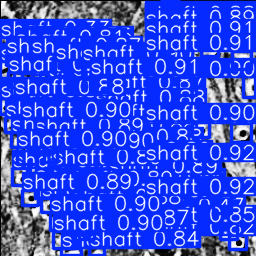

/content/DeployModelOnImages/images_for_detection/H1982_10775_jpg.rf.d98e2cfd88aab982ff2ff4712377a377.jpg


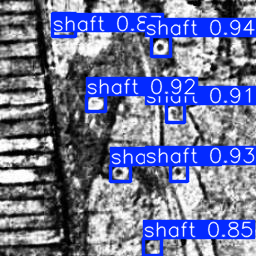

/content/DeployModelOnImages/images_for_detection/H1982_11765_jpg.rf.481f949b69ad1f25d120a8cf7b6cbd72.jpg


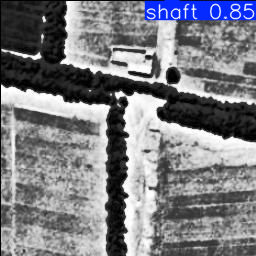

/content/DeployModelOnImages/images_for_detection/H1982_5950_jpg.rf.300e836e213acf4769321045a8e28e00.jpg


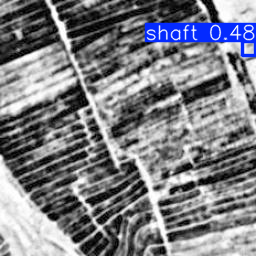

/content/DeployModelOnImages/images_for_detection/H1982_10773_jpg.rf.b2ef2fd5c97f3100b4462269cfe6cf10.jpg


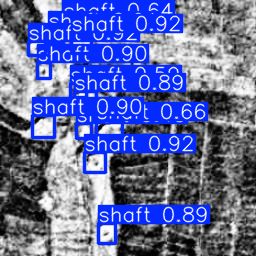

/content/DeployModelOnImages/images_for_detection/H1982_3791_jpg.rf.8a554bc613bc2d30c9a22d18fe2122fc.jpg


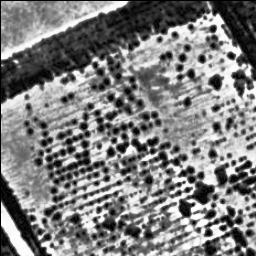

/content/DeployModelOnImages/images_for_detection/H1982_6812_jpg.rf.b1640ba124def25637628c938a164dd4.jpg


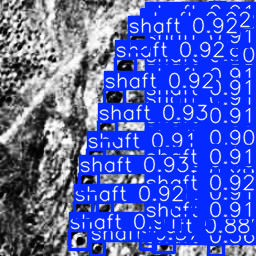

/content/DeployModelOnImages/images_for_detection/H1982_16801_jpg.rf.a6c9011df673f6d93cfd7ef8f0580607.jpg


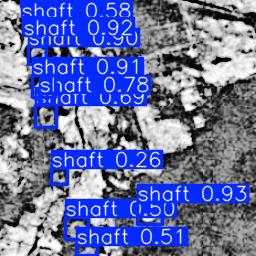

/content/DeployModelOnImages/images_for_detection/H1982_9766_jpg.rf.9a16f75f25cebdf1a66eebc1e3672d53.jpg


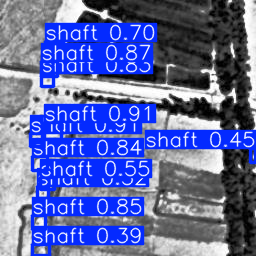

/content/DeployModelOnImages/images_for_detection/H1982_12140_jpg.rf.28db431a62f1d411b7fb89e744f3a11e.jpg


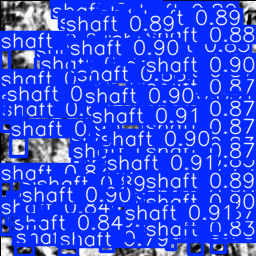

/content/DeployModelOnImages/images_for_detection/H1982_12716_jpg.rf.b8cc1afb109ab08943cd62c04005fee0.jpg


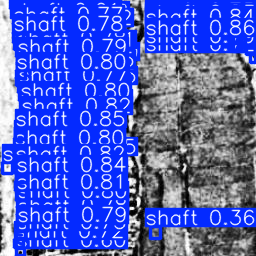

/content/DeployModelOnImages/images_for_detection/H1982_16808_jpg.rf.42acb2f9bd31aaad4d28f20186743236.jpg


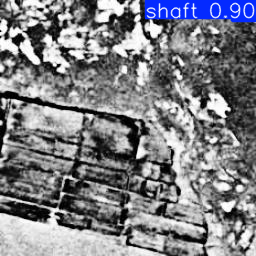

/content/DeployModelOnImages/images_for_detection/H1982_2821_jpg.rf.56590cf7e1f4b61a0b357db70f86eff1.jpg


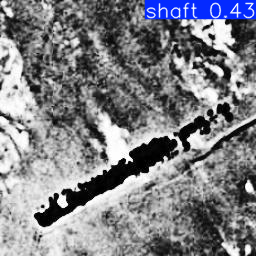

/content/DeployModelOnImages/images_for_detection/H1982_9764_jpg.rf.390410ad2125ae8c28d7032bcc1c528f.jpg


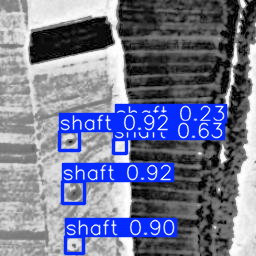

/content/DeployModelOnImages/images_for_detection/H1982_1697_jpg.rf.aa33c57b31839bd35613ca22e9ed594b.jpg


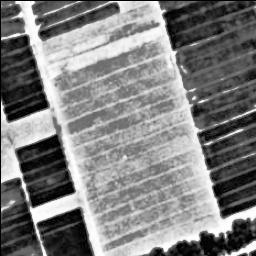

/content/DeployModelOnImages/images_for_detection/H1982_6814_jpg.rf.f559fc1232d9eac3c3bcf1e388337a9f.jpg


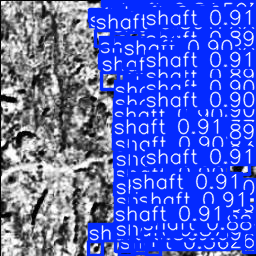

/content/DeployModelOnImages/images_for_detection/H1982_14032_jpg.rf.b172d54a8f22dd1404666e165b9ae785.jpg


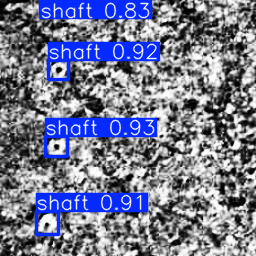

/content/DeployModelOnImages/images_for_detection/H1982_1487_jpg.rf.b91b4e55ecfff58f34299ca2cd55b789.jpg


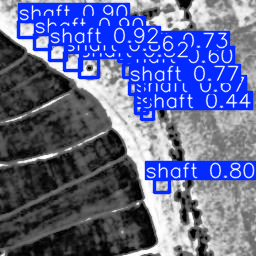

/content/DeployModelOnImages/images_for_detection/H1982_14220_jpg.rf.299248e74f797f94a523956f2ac43d0e.jpg


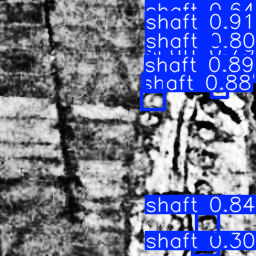

/content/DeployModelOnImages/images_for_detection/H1982_7469_jpg.rf.49834bbc6feae48330e26c82df5db5cc.jpg


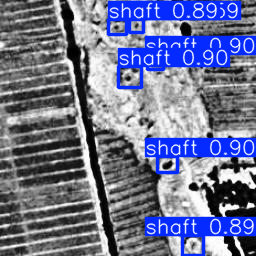

/content/DeployModelOnImages/images_for_detection/H1982_5949_jpg.rf.fc725030270b7ef1fe0e84da7ac389a5.jpg


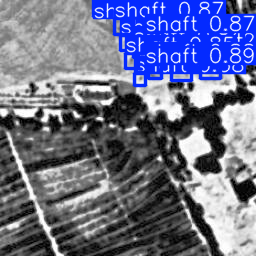

/content/DeployModelOnImages/images_for_detection/H1982_2821_jpg.rf.8e244b2c55bbfec15870d6a8b3129bf7.jpg


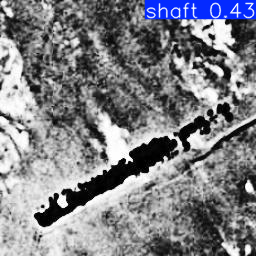

/content/DeployModelOnImages/images_for_detection/H1982_11762_jpg.rf.a2b87f697918b56984a31c45601f70f0.jpg


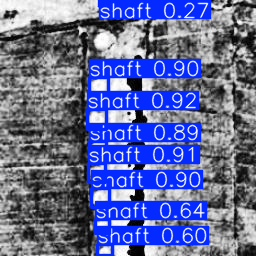

/content/DeployModelOnImages/images_for_detection/H1982_12130_jpg.rf.e08ace92d8fdb635302ab556e6cf7ba8.jpg


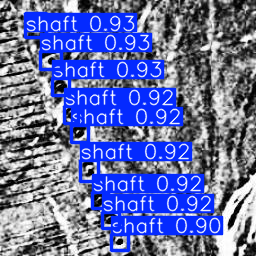

/content/DeployModelOnImages/images_for_detection/H1982_12126_jpg.rf.3ed7da5d5c741cf1c26a0f111756acd1.jpg


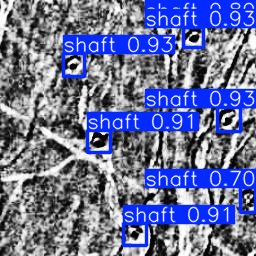

/content/DeployModelOnImages/images_for_detection/H1982_12809_jpg.rf.6b52412e5dc0036c0c14b1c1e97f30b9.jpg


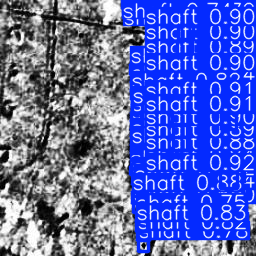

/content/DeployModelOnImages/images_for_detection/H1982_4113_jpg.rf.4e2ce95bc7d7678788c7fd7c62f1df7c.jpg


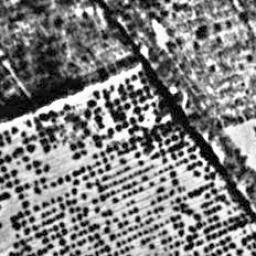

/content/DeployModelOnImages/images_for_detection/H1982_13862_jpg.rf.b68b05d07f35c8b9647fadb78e64f1f0.jpg


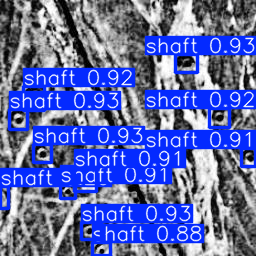

/content/DeployModelOnImages/images_for_detection/H1982_5951_jpg.rf.3c5c7054fdcffcea0db72f7750ac5e4e.jpg


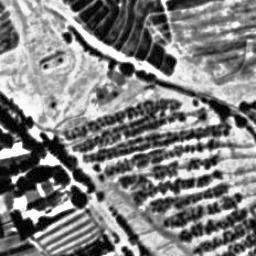

/content/DeployModelOnImages/images_for_detection/H1982_6814_jpg.rf.76ceab0f822ec0c2663369bec7d430b2.jpg


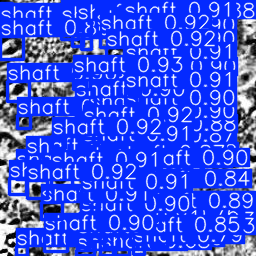

/content/DeployModelOnImages/images_for_detection/H1982_1485_jpg.rf.607c9bd84ad09cc13a94c5a5dbb5e18a.jpg


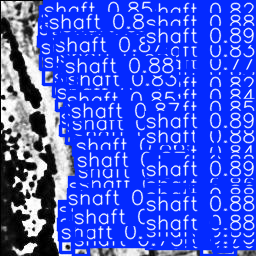

/content/DeployModelOnImages/images_for_detection/H1982_12134_jpg.rf.73f097cdd2e1ffe52037f268b90ac20d.jpg


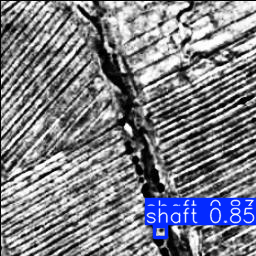

/content/DeployModelOnImages/images_for_detection/H1982_4391_jpg.rf.a537a55d5f23e2609a50c4d19d5093b2.jpg


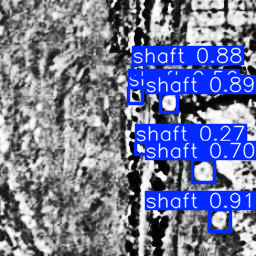

/content/DeployModelOnImages/images_for_detection/H1982_5953_jpg.rf.95b96acf66c533f1cf4aa011e1e4456b.jpg


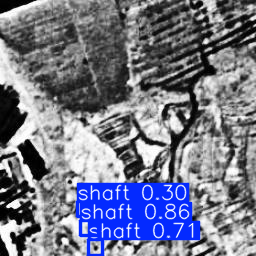

/content/DeployModelOnImages/images_for_detection/H1982_7461_jpg.rf.586f63ea65b9297dfb912992822ffd9f.jpg


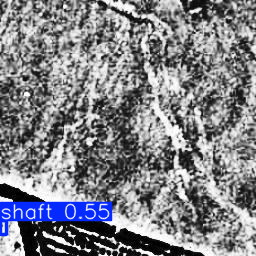

/content/DeployModelOnImages/images_for_detection/H1982_3788_jpg.rf.8cba46c98cbce4afc417691ad63c6103.jpg


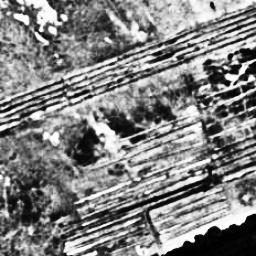

/content/DeployModelOnImages/images_for_detection/H1982_9768_jpg.rf.813dec7dc43dc8f8e5b56f2fc07a991f.jpg


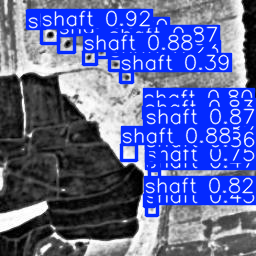

/content/DeployModelOnImages/images_for_detection/H1982_1491_jpg.rf.0296689a808432f1b5c72eca663df7bc.jpg


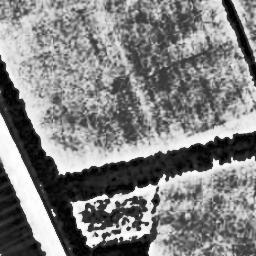

/content/DeployModelOnImages/images_for_detection/H1982_15433_jpg.rf.5fd03fc9e10c490896a31b3a6736f621.jpg


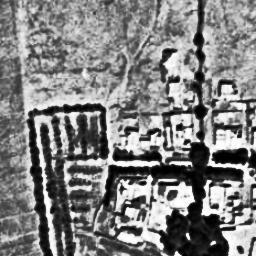

/content/DeployModelOnImages/images_for_detection/H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483bebc4d.jpg


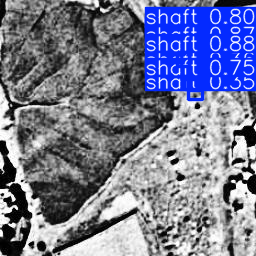

/content/DeployModelOnImages/images_for_detection/H1982_16803_jpg.rf.d5c9b656d83d0ddc1260ade51960bfc0.jpg


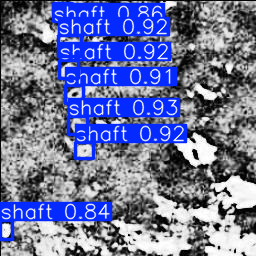

/content/DeployModelOnImages/images_for_detection/H1982_9462_jpg.rf.fca7b352463e827c9d4f84c660ce53c6.jpg


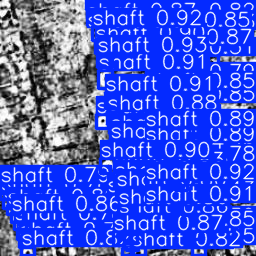

/content/DeployModelOnImages/images_for_detection/H1982_4116_jpg.rf.9335ae11290581d32a1e7e82f1600169.jpg


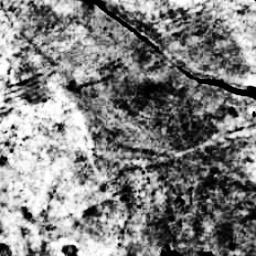

/content/DeployModelOnImages/images_for_detection/H1982_5955_jpg.rf.4a5b2226ad89f6776f4edc743a0dab92.jpg


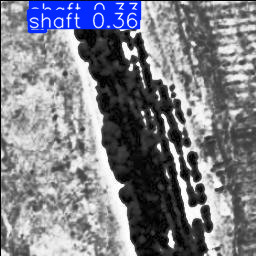

/content/DeployModelOnImages/images_for_detection/H1982_12717_jpg.rf.67f564787a5d350de1b2f662f5f0745a.jpg


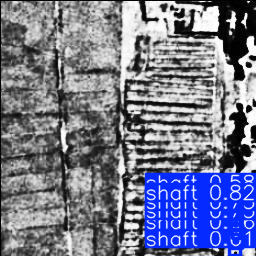

/content/DeployModelOnImages/images_for_detection/H1982_3783_jpg.rf.ef1eee759b47aa502598d657b9a3453b.jpg


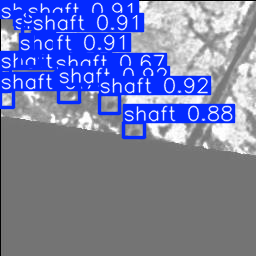

/content/DeployModelOnImages/images_for_detection/H1982_3784_jpg.rf.8f472fb5eb346222038ae36a7e9f2925.jpg


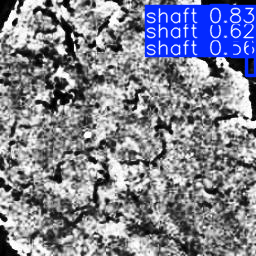

/content/DeployModelOnImages/images_for_detection/H1982_12803_jpg.rf.22c33af3f6d64296562170c9d2a174aa.jpg


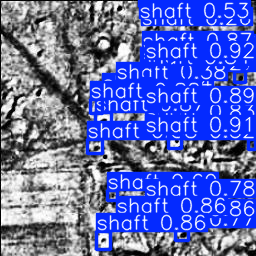

/content/DeployModelOnImages/images_for_detection/H1982_3244_jpg.rf.c99fd6475be6f15da67fc7680aaa39ca.jpg


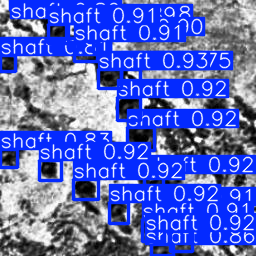

/content/DeployModelOnImages/images_for_detection/H1982_7641_jpg.rf.66c53ea950fbe1e3b60b86c160d2f7ce.jpg


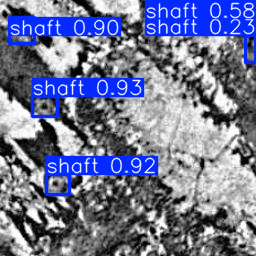

/content/DeployModelOnImages/images_for_detection/H1982_15425_jpg.rf.944f7610e2a030feb0397e628988e3b2.jpg


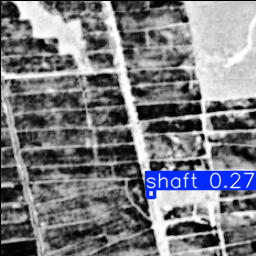

/content/DeployModelOnImages/images_for_detection/H1982_9696_jpg.rf.cee0f89dce30e6483acbb3a3f45ccf02.jpg


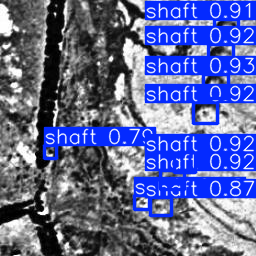

/content/DeployModelOnImages/images_for_detection/H1982_10779_jpg.rf.244812a693fbdccfcf534898f5728dac.jpg


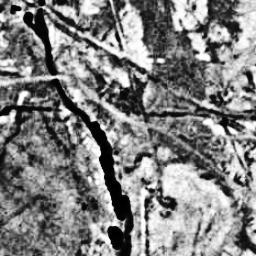

/content/DeployModelOnImages/images_for_detection/H1982_1694_jpg.rf.18e9983a6f059c8c3c9093ce970d994b.jpg


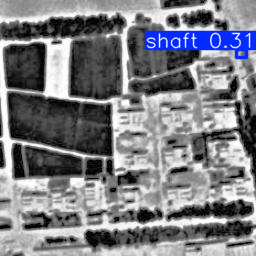

/content/DeployModelOnImages/images_for_detection/H1982_15430_jpg.rf.190648053f5f076a781930a8f0e8975d.jpg


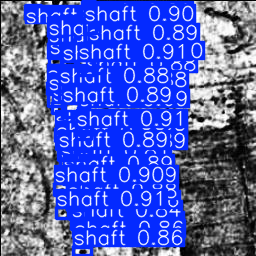

/content/DeployModelOnImages/images_for_detection/H1982_4111_jpg.rf.c02be72cd4d89e4b3229853301f9ec35.jpg


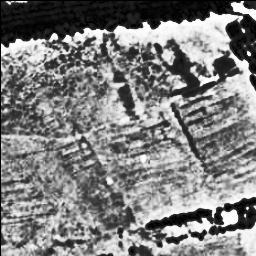

/content/DeployModelOnImages/images_for_detection/H1982_16811_jpg.rf.f8079878a227a369daa2d225218437f2.jpg


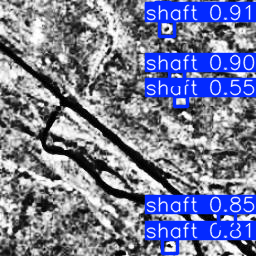

/content/DeployModelOnImages/images_for_detection/H1982_12818_jpg.rf.2cebccc4b75c40b696ee50af30690430.jpg


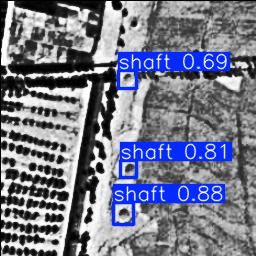

/content/DeployModelOnImages/images_for_detection/H1982_14224_jpg.rf.85b23060408c12cadb186f45ea3bd4ad.jpg


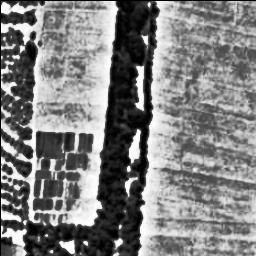

/content/DeployModelOnImages/images_for_detection/H1982_13858_jpg.rf.e4f9e61909db107ba410957fbc52e795.jpg


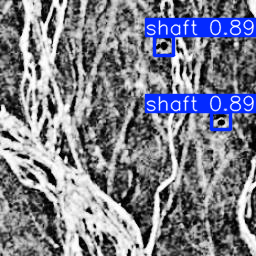

/content/DeployModelOnImages/images_for_detection/H1982_12130_jpg.rf.a45b823d20f06269648f51a4abcfa009.jpg


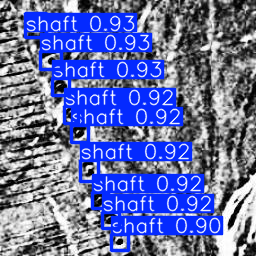

/content/DeployModelOnImages/images_for_detection/H1982_4108_jpg.rf.6b9cd7ae4045e9e7e39c9cd88e78f315.jpg


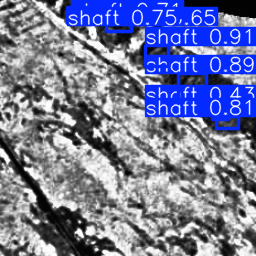

/content/DeployModelOnImages/images_for_detection/H1982_16812_jpg.rf.03fa110b893621bd92b6dad79356916b.jpg


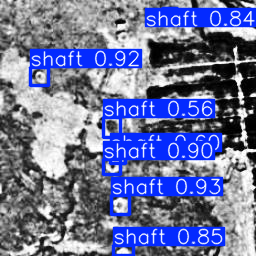

/content/DeployModelOnImages/images_for_detection/H1982_15431_jpg.rf.f60dee60ec61215ba3ac84ee6b7652a7.jpg


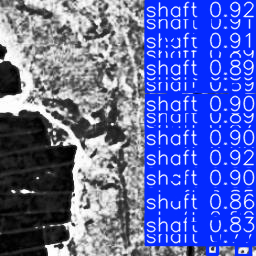

/content/DeployModelOnImages/images_for_detection/H1982_11482_jpg.rf.5cf1e896927e65d37355b413c4a76e78.jpg


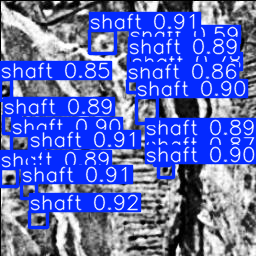

/content/DeployModelOnImages/images_for_detection/H1982_4110_jpg.rf.455e4caf939efb8bff83c4269fa892f4.jpg


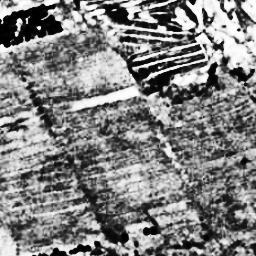

/content/DeployModelOnImages/images_for_detection/H1982_1693_jpg.rf.f9676d8c6651de23c6b32452c355ec1d.jpg


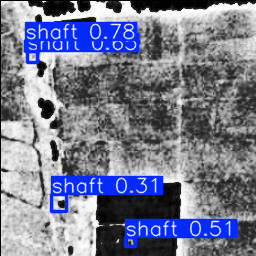

/content/DeployModelOnImages/images_for_detection/H1982_2817_jpg.rf.c1d94988b0a699f923f6d9667104fa0c.jpg


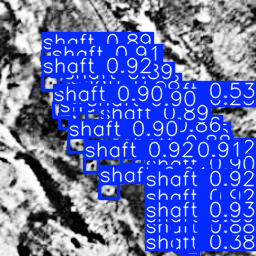

/content/DeployModelOnImages/images_for_detection/H1982_6817_jpg.rf.366ca73a005c698f5abf2c0f136c0f77.jpg


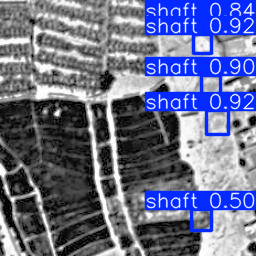

/content/DeployModelOnImages/images_for_detection/H1982_6346_jpg.rf.56e80dea70fb7927a82426e7686f6d07.jpg


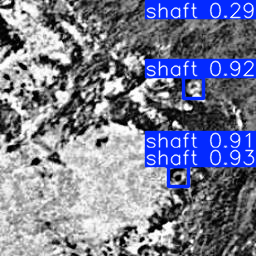

/content/DeployModelOnImages/images_for_detection/H1982_7391_jpg.rf.93b228335441aa999e0840d4f0ab2714.jpg


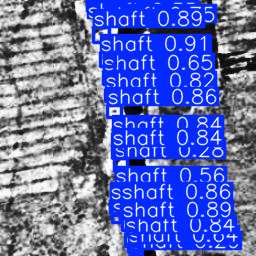

/content/DeployModelOnImages/images_for_detection/H1982_9695_jpg.rf.2e4ba8f6379d43638c6587c501fa4b0b.jpg


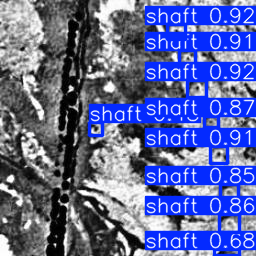

/content/DeployModelOnImages/images_for_detection/H1982_6342_jpg.rf.a4a09551095e7a1162eda65fff298585.jpg


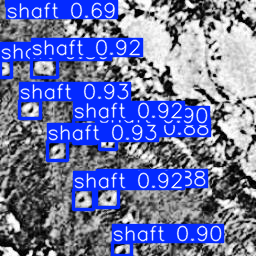

/content/DeployModelOnImages/images_for_detection/H1982_12710_jpg.rf.bebca5fd05ff6d947c7da0331a68fa13.jpg


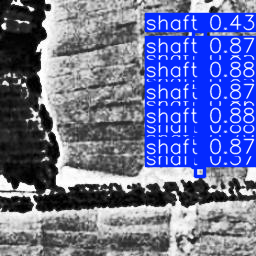

/content/DeployModelOnImages/images_for_detection/H1982_12141_jpg.rf.488491e4d73a5b17766cb9653db85010.jpg


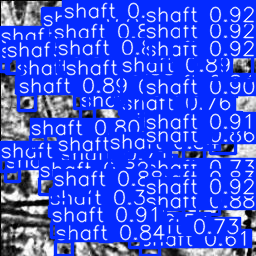

/content/DeployModelOnImages/images_for_detection/H1982_7468_jpg.rf.93081b322f04005f81b056cf9abe9c25.jpg


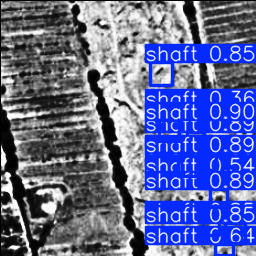

/content/DeployModelOnImages/images_for_detection/H1982_1692_jpg.rf.005e13f336b16cc263321923a57f8445.jpg


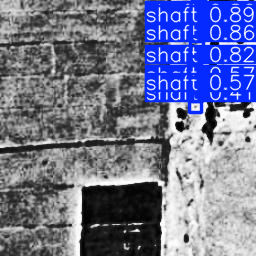

/content/DeployModelOnImages/images_for_detection/H1982_12815_jpg.rf.e2bd24cfaeb80473d8e9c85629ae39ea.jpg


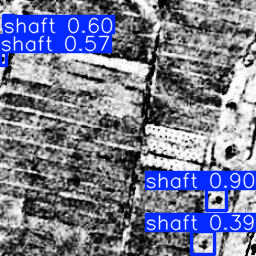

/content/DeployModelOnImages/images_for_detection/H1982_1696_jpg.rf.a7d1d58a3e515455e179e473b28eef9b.jpg


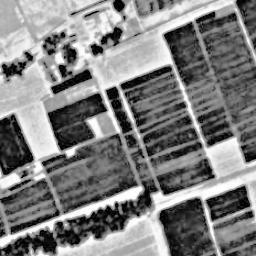

/content/DeployModelOnImages/images_for_detection/H1982_9687_jpg.rf.521d39c3b2fd195190eb0b9393194b0d.jpg


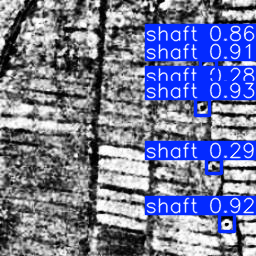

In [179]:
print(image_paths)
# Clear out previous runs.
runs_dir = "/content/runs/detect"
if os.path.exists(runs_dir):
  shutil.rmtree(runs_dir)

# Run the model and save the .txt files and the confidence of each prediction.
results = model(image_paths, save=True, save_txt=True, save_conf=True, conf=0.22, iou = 0.3)
print("\n")

# Display results.
print(f"The model was run on {num_images} images.")
if (user_provided_year == 1974 or user_provided_year == 1982 or user_provided_year == 1984 or user_provided_year == 2019):
  print(f"These images are from {user_provided_year}.")
else:
  print("These images were sampled from 1974, 1982, 1984, and 2019.")

print("\n")
for r in results:
  print(r.path)
  r.show()

# Post-Processing

In post-processing, we will attempt to remove any duplicate classifications caused by overlapping file boundaries.

---


We will begin by combining the .csv files returned by running our model.

In [180]:
# Get all saved .txt files, with the following format.
all_txts = glob.glob("/content/runs/detect/predict/labels/*.txt")

# Change the txt files to a DataFrame for ease of merging (done below).
dfs = []
for file in all_txts:
  # Get the contents of this .txt.
  df = pd.read_csv(file, sep=" ", header=None)
  # Assign to columns of this DataFrame.
  df.columns = ["class", "x_center", "y_center", "width", "height", "confidence"]
  # The name of this image is the last file name, without the appending .txt.
  df["image"] = os.path.basename(file).replace(".txt", "")

  # Append to the data frame.
  dfs.append(df)

# Merge and save the results.
combined_classifications_df = pd.concat(dfs, ignore_index=True)

# Print the combined results (all classifications).
print(combined_classifications_df)

      class  x_center  y_center     width    height  confidence  \
0         0  0.715385  0.231635  0.047944  0.053621    0.883247   
1         0  0.697153  0.191193  0.046862  0.042460    0.867986   
2         0  0.651782  0.120048  0.044472  0.042984    0.803015   
3         0  0.678452  0.156644  0.049426  0.042922    0.780412   
4         0  0.745044  0.324191  0.050000  0.047212    0.751931   
...     ...       ...       ...       ...       ...         ...   
1113      0  0.326817  0.443206  0.043769  0.044007    0.693461   
1114      0  0.131162  0.048334  0.061584  0.054474    0.677264   
1115      0  0.314112  0.911303  0.054917  0.031914    0.658476   
1116      0  0.219110  0.155293  0.049563  0.043062    0.465022   
1117      0  0.213048  0.345303  0.053859  0.048178    0.394257   

                                                  image  
0     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...  
1     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...  
2     H1982_9770_jpg.

We will now modify this DataFrame to be contained within seven columns, defined as follows:

*   image_id
*   numeric_id
*   confidence
*   top_bound_percentage
*   bottom_bound_percentage
*   left_bound_percentage
*   right_bound_percentage



In [181]:
# The resulting DataFrame to be returned.
results = []

# For each row (each prediction) in the combined classifications DataFrame.
for i, row in combined_classifications_df.iterrows():
  image_id = row[6]
  confidence = row[5]

  # Get the numeric id.
  year, numeric_id, jpg = image_id.split("_")

  # Calculate the percentages.
  x_center = row[1]
  y_center = row[2]
  width = row[3]
  height = row[4]

  top_pct = x_center - width/2
  bottom_pct = x_center + width/2
  left_pct = y_center - height/2
  right_pct = y_center + height/2

  # Append this information to results.
  results.append({
      "image_id": image_id,
      "numeric_id": numeric_id,
      "confidence": confidence,
      "top_bound_percentage": top_pct,
      "bottom_bound_percentage": bottom_pct,
      "left_bound_percentage": left_pct,
      "right_bound_percentage": right_pct
    })

# Save results to a DataFrame.
final_predictions_df = pd.DataFrame(results)

# Print the results.
print(final_predictions_df)

                                               image_id numeric_id  \
0     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...       9770   
1     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...       9770   
2     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...       9770   
3     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...       9770   
4     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...       9770   
...                                                 ...        ...   
1113  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...      15430   
1114  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...      15430   
1115  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...      15430   
1116  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...      15430   
1117  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...      15430   

      confidence  top_bound_percentage  bottom_bound_percentage  \
0       0.883247              0.691413                 0.739357   
1       0.867986         

/tmp/ipython-input-2476978795.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  image_id = row[6]
/tmp/ipython-input-2476978795.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  confidence = row[5]
/tmp/ipython-input-2476978795.py:13: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  x_center = row[1]
/tmp/ipython-input-2476978795.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version,

The above top_bound_percentage, bottom_bound_percentage, left_bound_percentage, and right_bound_percentage are normalized as a percentage of the image width/height. We will now seek to translate these values to a global projection system, using a predefined grid. We will update the above DataFrame columns as follows:


*   top_bound_percentage -> global_top
*   bottom_bound_percentage -> global_bottom
*   left_bound_percentage -> global_left
*   right_bound_percentage -> global_right

We will also add a column: *wkt*, which will store the WKT polygon for the bounding box.



In [182]:
# Local in the grid of global coordinates, for each image_id.
grid_df = pd.read_csv("/content/DeployModelOnImages/grid.csv")

# Convert title_id to a string for comparison.
grid_df["tile_id"] = grid_df["tile_id"].astype(str)

# Merge predictions with grid based on image numeric_id and tile_id.
merged_df = final_predictions_df.merge(grid_df, left_on="numeric_id", right_on="tile_id", how="inner")

# Calculate the absolute coordinates for bounding boxes within the global map.
results = []
for _, row in merged_df.iterrows():
  # Get the tile boundaries from the grid.
  tile_left, tile_top, tile_right, tile_bottom = row["left"], row["top"], row["right"], row["bottom"]

  # Get the tile size.
  tile_width = tile_right - tile_left
  tile_height = tile_bottom - tile_top

  # Convert relative percentages to absolute positions.
  abs_left = tile_left + row["left_bound_percentage"] * tile_width
  abs_right = tile_left + row["right_bound_percentage"] * tile_width
  abs_top = tile_top + row["top_bound_percentage"] * tile_height
  abs_bottom = tile_top + row["bottom_bound_percentage"] * tile_height

  # Create WKT polygon (clockwise order).
  wkt_polygon = (
      f"POLYGON (({abs_left} {abs_top}, {abs_right} {abs_top}, {abs_right} {abs_bottom}, {abs_left} {abs_bottom}, {abs_left} {abs_top}))"
  )

  results.append({
        "image_id": row["image_id"],
        "confidence": row["confidence"],
        "top_bound_percentage": row["top_bound_percentage"],
        "bottom_bound_percentage": row["bottom_bound_percentage"],
        "left_bound_percentage": row["left_bound_percentage"],
        "right_bound_percentage": row["right_bound_percentage"],
        "global_left": abs_left,
        "global_right": abs_right,
        "global_top": abs_top,
        "global_bottom": abs_bottom,
        "wkt": wkt_polygon
    })

# Save results to a DataFrame.
globally_mapped_predictions_df = pd.DataFrame(results)

# Print the results.
print(globally_mapped_predictions_df)


                                               image_id  confidence  \
0     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.883247   
1     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.867986   
2     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.803015   
3     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.780412   
4     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.751931   
...                                                 ...         ...   
1113  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.693461   
1114  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.677264   
1115  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.658476   
1116  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.465022   
1117  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.394257   

      top_bound_percentage  bottom_bound_percentage  left_bound_percentage  \
0                 0.691413                 0.739357               0.2

Now we will seek to remove all overlapping predictions, which occur due to the overlap of tile borders. We will remove any boxes that have a IoU (Jaccard) threshhold over 0.9.

In [183]:
IOU_THRESHOLD_OVERLAPPING = 0.90

# This function will calculate the IoU (Jaccard) threshold.
def pair_iou(geom_a, area_a, geom_b, area_b):
    inter = geom_a.intersection(geom_b)
    if inter.is_empty:
        return 0.0
    inter_area = inter.area
    union_area = area_a + area_b - inter_area
    if union_area <= 0:
        return 0.0
    return inter_area / union_area

In [184]:
# Note that this part will remove a lot more overlaps when the images are adjacent
# Load the WKT to a GeoDataFrame
gdf = gpd.GeoDataFrame(globally_mapped_predictions_df, geometry=globally_mapped_predictions_df["wkt"].apply(wkt.loads), crs="EPSG:3857")

# Fix any invalid geometries and project to equal-area CRS for area math.
gdf["geometry"] = gdf.geometry.apply(lambda g: make_valid(g) if g and not g.is_valid else g)
gdf = gdf.to_crs(3857)

# Precompute areas and spatial index.
gdf["__area"] = gdf.geometry.area
sidx = gdf.sindex

# Sort indices by area, smallest to largest, so we only ever drop the smaller one.
idx_sorted_small_to_large = gdf["__area"].sort_values().index.tolist()

to_drop = set()
areas = gdf["__area"]

for i in idx_sorted_small_to_large:
    # If we have already identified this idx to be dropped, continue.
    if i in to_drop:
        continue

    geom_i = gdf.at[i, "geometry"]
    # If geometry is empty, add it to set to be dropped and continue.
    if geom_i is None or geom_i.is_empty:
        to_drop.add(i)
        continue

    # Query bbox candidates, keep only strictly larger polygons.
    cand_ids = list(sidx.intersection(geom_i.bounds))
    cand_ids = [j for j in cand_ids if j != i and areas.at[j] > areas.at[i]]

    # If any larger candidate is too similar, drop the smaller (i).
    for j in cand_ids:
        geom_j = gdf.at[j, "geometry"]
        if geom_j is None or geom_j.is_empty:
            continue

        # If centroid of a smaller polygon is inside a larger polygon, drop this smaller polygon.
        if geom_i.centroid.within(geom_j):
            to_drop.add(i)
            break

        # If IoU exceeds the threshold, drop this smaller polygon.
        iou = pair_iou(geom_i, areas.at[i], geom_j, areas.at[j])
        if iou >= IOU_THRESHOLD_OVERLAPPING:
            to_drop.add(i)
            break

# Keep all polygons that are not marked to be dropped.
filtered = gdf.drop(index=list(to_drop)).copy()

# Update the csv.
filtered_latlon = filtered.to_crs(3857)
filtered_latlon["wkt"] = filtered_latlon.geometry.to_wkt()
out_cols = [c for c in globally_mapped_predictions_df.columns if c != "wkt"] + ["wkt"]
filtered_latlon[out_cols].to_csv("cleaned_predictions.csv", index=False)

# Print the results.
cleaned_predictions_df = pd.read_csv("cleaned_predictions.csv")
print(cleaned_predictions_df)
print(f"Input polygons: {len(gdf)}")
print(f"Removed near-duplicates/smaller overlaps: {len(to_drop)}")
print(f"Kept: {len(filtered)}")


                                               image_id  confidence  \
0     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.883247   
1     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.867986   
2     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.803015   
3     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.780412   
4     H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483be...    0.751931   
...                                                 ...         ...   
1092  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.693461   
1093  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.677264   
1094  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.658476   
1095  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.465022   
1096  H1982_15430_jpg.rf.190648053f5f076a781930a8f0e...    0.394257   

      top_bound_percentage  bottom_bound_percentage  left_bound_percentage  \
0                 0.691413                 0.739357               0.2

Finally, we will display the results of removing any overlapping predictions.

/content/DeployModelOnImages/images_for_detection/H1982_13866_jpg.rf.b8c331b67fe4a0545e21f17641fdd671.jpg


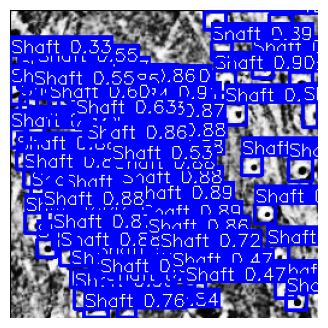

/content/DeployModelOnImages/images_for_detection/H1982_10775_jpg.rf.d98e2cfd88aab982ff2ff4712377a377.jpg


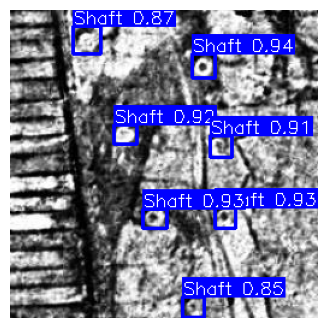

/content/DeployModelOnImages/images_for_detection/H1982_11765_jpg.rf.481f949b69ad1f25d120a8cf7b6cbd72.jpg


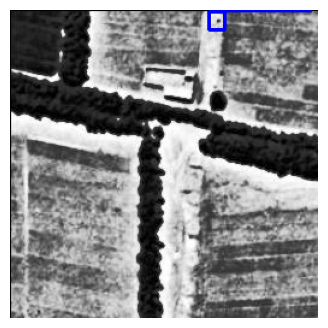

/content/DeployModelOnImages/images_for_detection/H1982_5950_jpg.rf.300e836e213acf4769321045a8e28e00.jpg


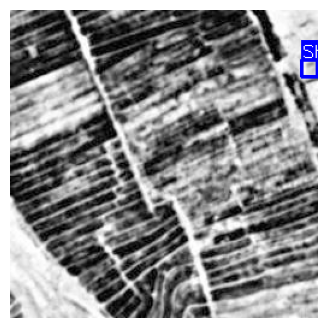

/content/DeployModelOnImages/images_for_detection/H1982_10773_jpg.rf.b2ef2fd5c97f3100b4462269cfe6cf10.jpg


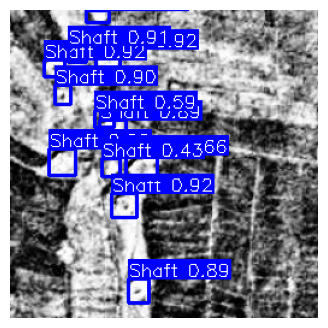

/content/DeployModelOnImages/images_for_detection/H1982_3791_jpg.rf.8a554bc613bc2d30c9a22d18fe2122fc.jpg


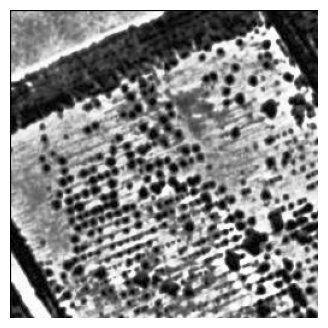

/content/DeployModelOnImages/images_for_detection/H1982_6812_jpg.rf.b1640ba124def25637628c938a164dd4.jpg


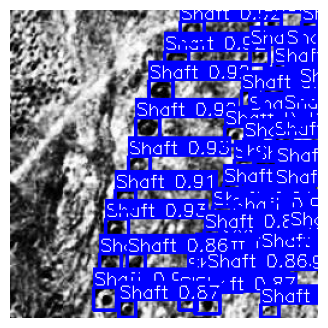

/content/DeployModelOnImages/images_for_detection/H1982_16801_jpg.rf.a6c9011df673f6d93cfd7ef8f0580607.jpg


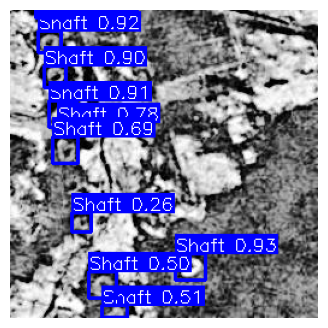

/content/DeployModelOnImages/images_for_detection/H1982_9766_jpg.rf.9a16f75f25cebdf1a66eebc1e3672d53.jpg


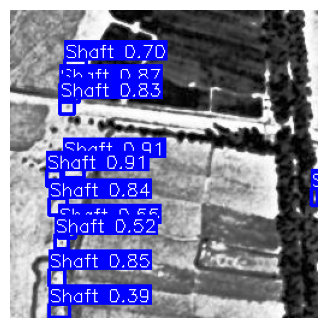

/content/DeployModelOnImages/images_for_detection/H1982_12140_jpg.rf.28db431a62f1d411b7fb89e744f3a11e.jpg


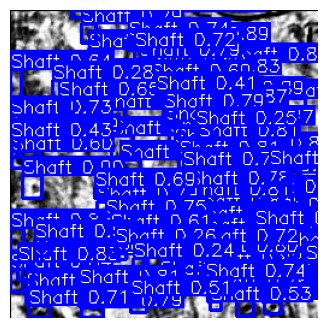

/content/DeployModelOnImages/images_for_detection/H1982_12716_jpg.rf.b8cc1afb109ab08943cd62c04005fee0.jpg


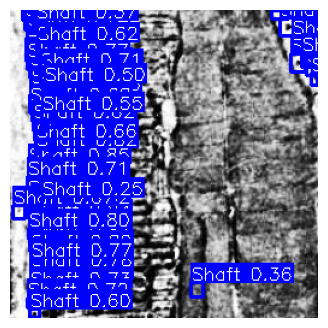

/content/DeployModelOnImages/images_for_detection/H1982_16808_jpg.rf.42acb2f9bd31aaad4d28f20186743236.jpg


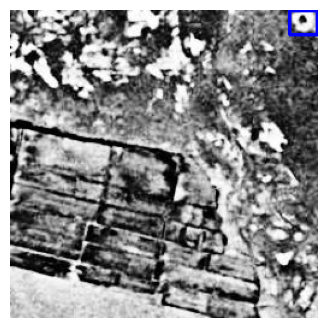

/content/DeployModelOnImages/images_for_detection/H1982_2821_jpg.rf.56590cf7e1f4b61a0b357db70f86eff1.jpg


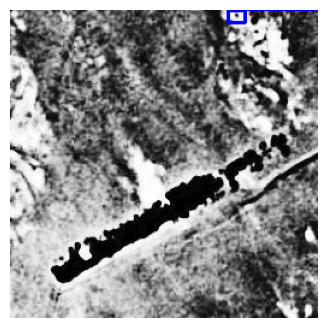

/content/DeployModelOnImages/images_for_detection/H1982_9764_jpg.rf.390410ad2125ae8c28d7032bcc1c528f.jpg


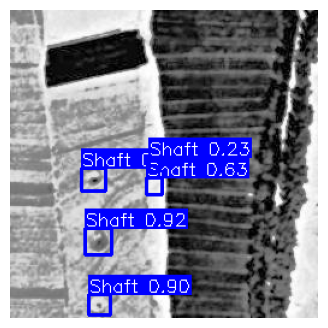

/content/DeployModelOnImages/images_for_detection/H1982_1697_jpg.rf.aa33c57b31839bd35613ca22e9ed594b.jpg


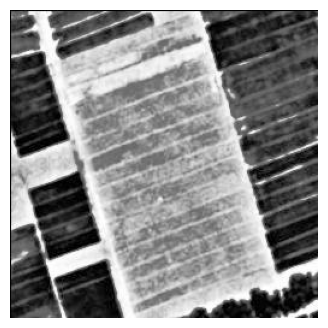

/content/DeployModelOnImages/images_for_detection/H1982_6814_jpg.rf.f559fc1232d9eac3c3bcf1e388337a9f.jpg


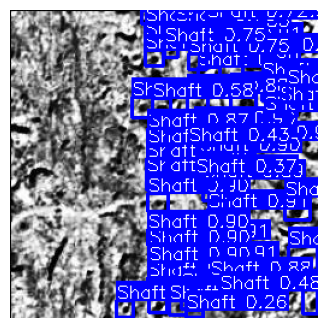

/content/DeployModelOnImages/images_for_detection/H1982_14032_jpg.rf.b172d54a8f22dd1404666e165b9ae785.jpg


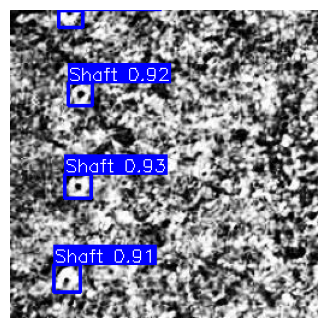

/content/DeployModelOnImages/images_for_detection/H1982_1487_jpg.rf.b91b4e55ecfff58f34299ca2cd55b789.jpg


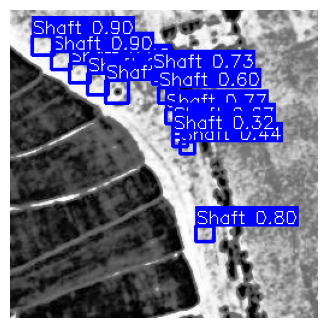

/content/DeployModelOnImages/images_for_detection/H1982_14220_jpg.rf.299248e74f797f94a523956f2ac43d0e.jpg


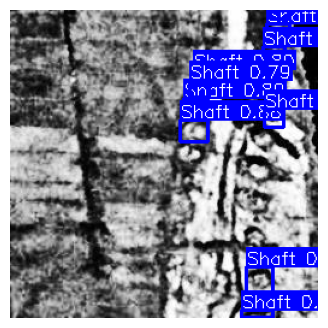

/content/DeployModelOnImages/images_for_detection/H1982_7469_jpg.rf.49834bbc6feae48330e26c82df5db5cc.jpg


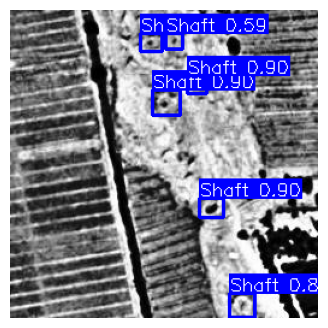

/content/DeployModelOnImages/images_for_detection/H1982_5949_jpg.rf.fc725030270b7ef1fe0e84da7ac389a5.jpg


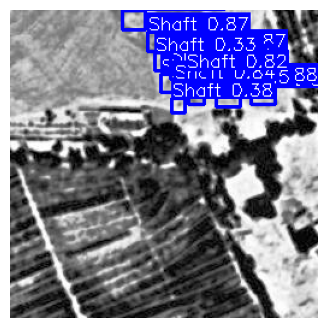

/content/DeployModelOnImages/images_for_detection/H1982_2821_jpg.rf.8e244b2c55bbfec15870d6a8b3129bf7.jpg


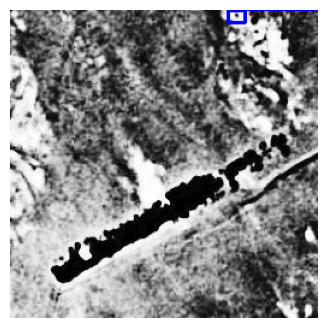

/content/DeployModelOnImages/images_for_detection/H1982_11762_jpg.rf.a2b87f697918b56984a31c45601f70f0.jpg


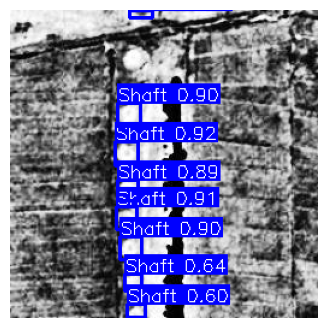

/content/DeployModelOnImages/images_for_detection/H1982_12130_jpg.rf.e08ace92d8fdb635302ab556e6cf7ba8.jpg


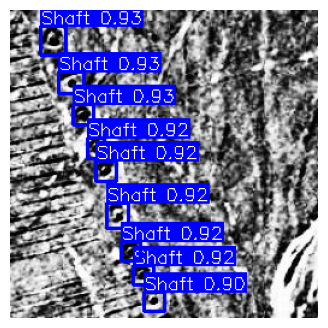

/content/DeployModelOnImages/images_for_detection/H1982_12126_jpg.rf.3ed7da5d5c741cf1c26a0f111756acd1.jpg


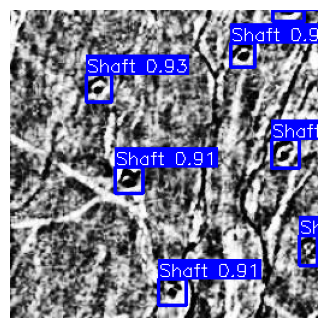

/content/DeployModelOnImages/images_for_detection/H1982_12809_jpg.rf.6b52412e5dc0036c0c14b1c1e97f30b9.jpg


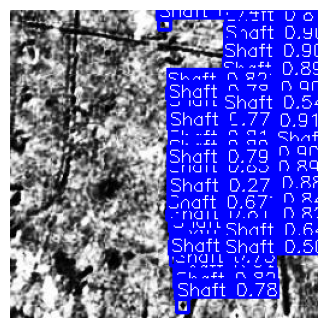

/content/DeployModelOnImages/images_for_detection/H1982_4113_jpg.rf.4e2ce95bc7d7678788c7fd7c62f1df7c.jpg


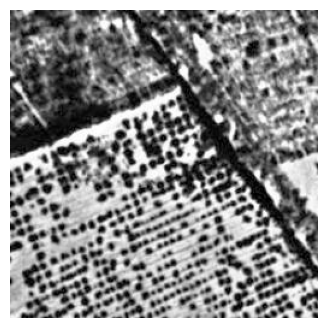

/content/DeployModelOnImages/images_for_detection/H1982_13862_jpg.rf.b68b05d07f35c8b9647fadb78e64f1f0.jpg


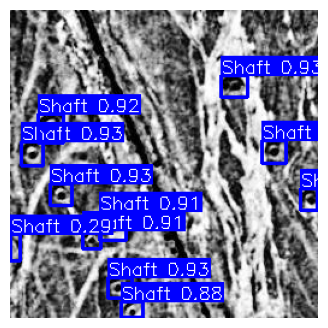

/content/DeployModelOnImages/images_for_detection/H1982_5951_jpg.rf.3c5c7054fdcffcea0db72f7750ac5e4e.jpg


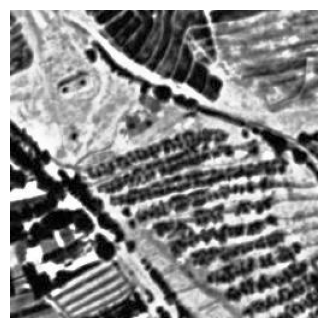

/content/DeployModelOnImages/images_for_detection/H1982_6814_jpg.rf.76ceab0f822ec0c2663369bec7d430b2.jpg


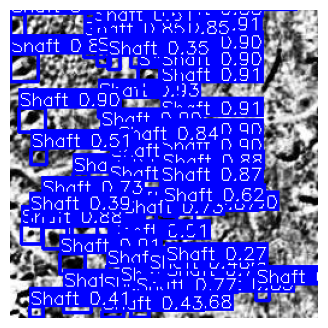

/content/DeployModelOnImages/images_for_detection/H1982_1485_jpg.rf.607c9bd84ad09cc13a94c5a5dbb5e18a.jpg


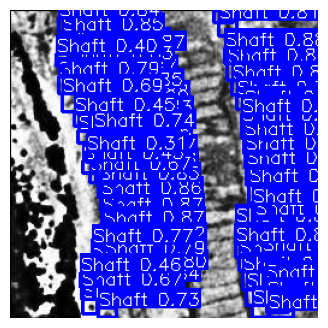

/content/DeployModelOnImages/images_for_detection/H1982_12134_jpg.rf.73f097cdd2e1ffe52037f268b90ac20d.jpg


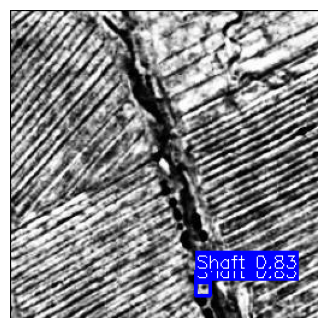

/content/DeployModelOnImages/images_for_detection/H1982_4391_jpg.rf.a537a55d5f23e2609a50c4d19d5093b2.jpg


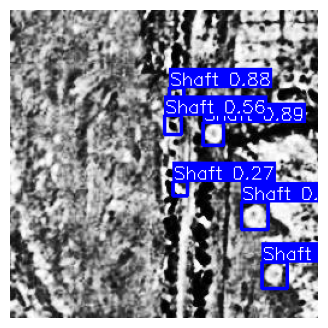

/content/DeployModelOnImages/images_for_detection/H1982_5953_jpg.rf.95b96acf66c533f1cf4aa011e1e4456b.jpg


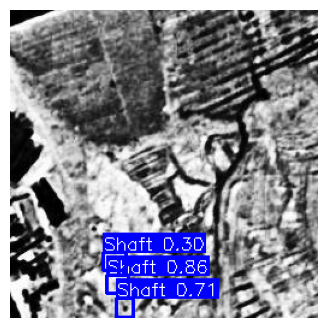

/content/DeployModelOnImages/images_for_detection/H1982_7461_jpg.rf.586f63ea65b9297dfb912992822ffd9f.jpg


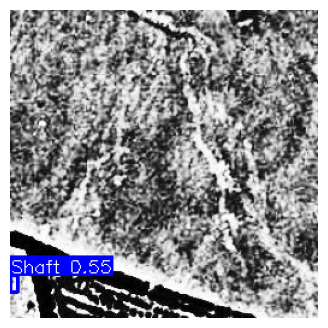

/content/DeployModelOnImages/images_for_detection/H1982_3788_jpg.rf.8cba46c98cbce4afc417691ad63c6103.jpg


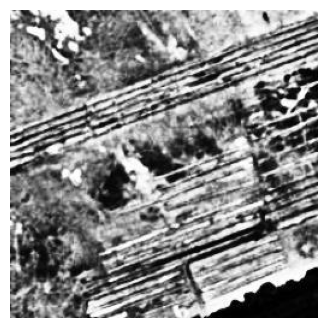

/content/DeployModelOnImages/images_for_detection/H1982_9768_jpg.rf.813dec7dc43dc8f8e5b56f2fc07a991f.jpg


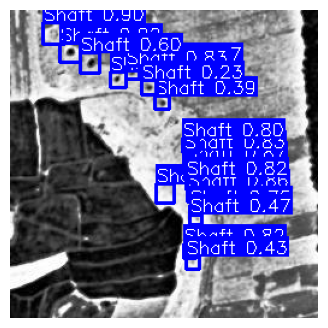

/content/DeployModelOnImages/images_for_detection/H1982_1491_jpg.rf.0296689a808432f1b5c72eca663df7bc.jpg


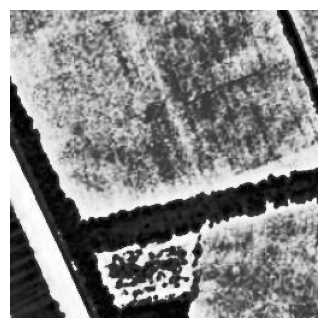

/content/DeployModelOnImages/images_for_detection/H1982_15433_jpg.rf.5fd03fc9e10c490896a31b3a6736f621.jpg


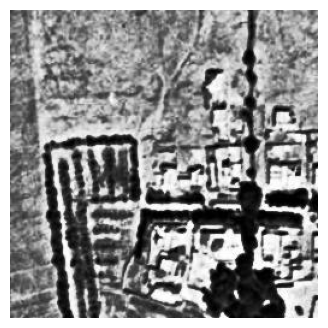

/content/DeployModelOnImages/images_for_detection/H1982_9770_jpg.rf.ee6204f23c855fe65a31cb0483bebc4d.jpg


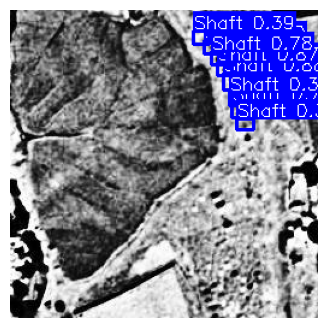

/content/DeployModelOnImages/images_for_detection/H1982_16803_jpg.rf.d5c9b656d83d0ddc1260ade51960bfc0.jpg


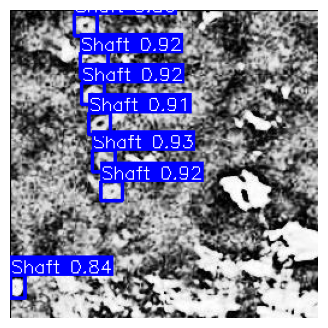

/content/DeployModelOnImages/images_for_detection/H1982_9462_jpg.rf.fca7b352463e827c9d4f84c660ce53c6.jpg


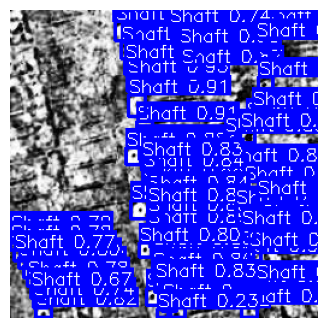

/content/DeployModelOnImages/images_for_detection/H1982_4116_jpg.rf.9335ae11290581d32a1e7e82f1600169.jpg


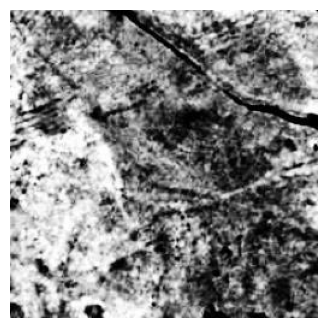

/content/DeployModelOnImages/images_for_detection/H1982_5955_jpg.rf.4a5b2226ad89f6776f4edc743a0dab92.jpg


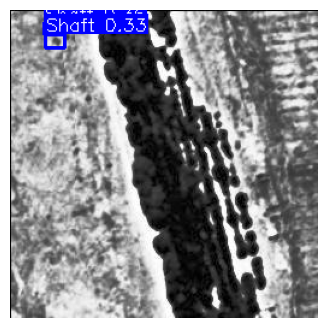

/content/DeployModelOnImages/images_for_detection/H1982_12717_jpg.rf.67f564787a5d350de1b2f662f5f0745a.jpg


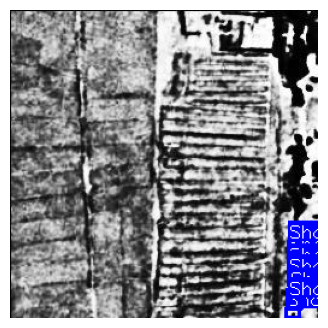

/content/DeployModelOnImages/images_for_detection/H1982_3783_jpg.rf.ef1eee759b47aa502598d657b9a3453b.jpg


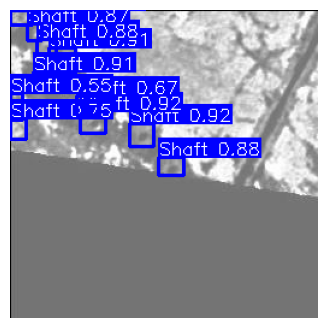

/content/DeployModelOnImages/images_for_detection/H1982_3784_jpg.rf.8f472fb5eb346222038ae36a7e9f2925.jpg


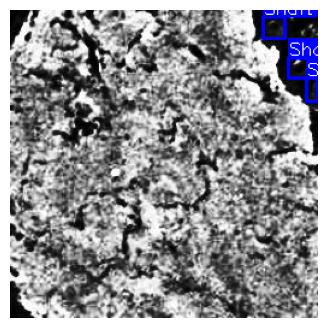

/content/DeployModelOnImages/images_for_detection/H1982_12803_jpg.rf.22c33af3f6d64296562170c9d2a174aa.jpg


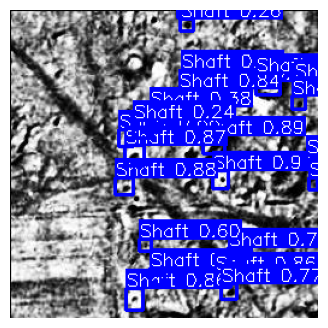

/content/DeployModelOnImages/images_for_detection/H1982_3244_jpg.rf.c99fd6475be6f15da67fc7680aaa39ca.jpg


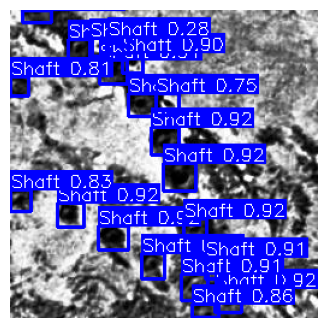

/content/DeployModelOnImages/images_for_detection/H1982_7641_jpg.rf.66c53ea950fbe1e3b60b86c160d2f7ce.jpg


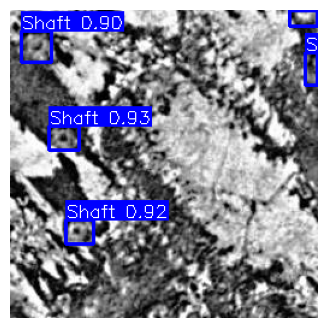

/content/DeployModelOnImages/images_for_detection/H1982_15425_jpg.rf.944f7610e2a030feb0397e628988e3b2.jpg


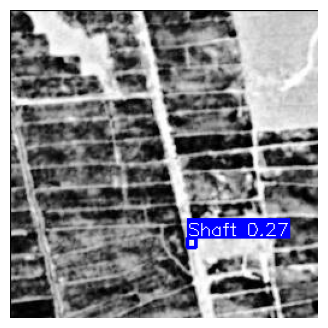

/content/DeployModelOnImages/images_for_detection/H1982_9696_jpg.rf.cee0f89dce30e6483acbb3a3f45ccf02.jpg


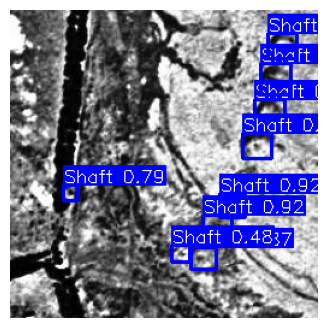

/content/DeployModelOnImages/images_for_detection/H1982_10779_jpg.rf.244812a693fbdccfcf534898f5728dac.jpg


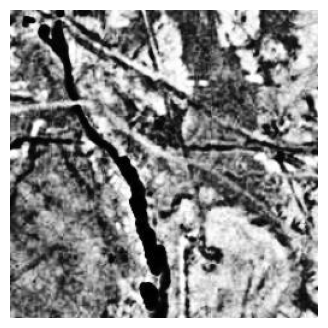

/content/DeployModelOnImages/images_for_detection/H1982_1694_jpg.rf.18e9983a6f059c8c3c9093ce970d994b.jpg


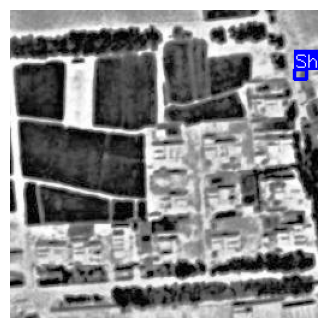

/content/DeployModelOnImages/images_for_detection/H1982_15430_jpg.rf.190648053f5f076a781930a8f0e8975d.jpg


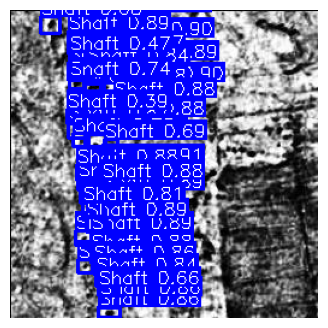

/content/DeployModelOnImages/images_for_detection/H1982_4111_jpg.rf.c02be72cd4d89e4b3229853301f9ec35.jpg


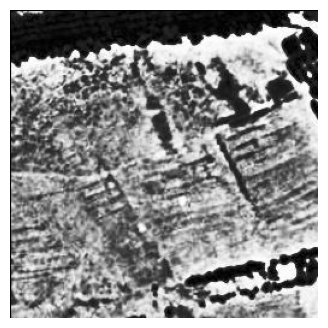

/content/DeployModelOnImages/images_for_detection/H1982_16811_jpg.rf.f8079878a227a369daa2d225218437f2.jpg


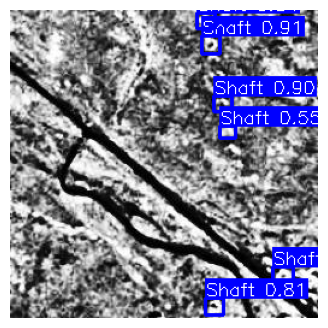

/content/DeployModelOnImages/images_for_detection/H1982_12818_jpg.rf.2cebccc4b75c40b696ee50af30690430.jpg


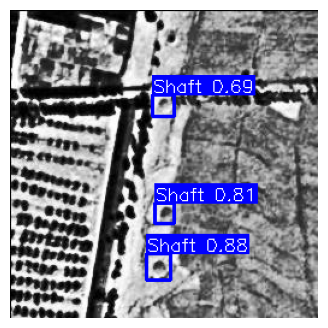

/content/DeployModelOnImages/images_for_detection/H1982_14224_jpg.rf.85b23060408c12cadb186f45ea3bd4ad.jpg


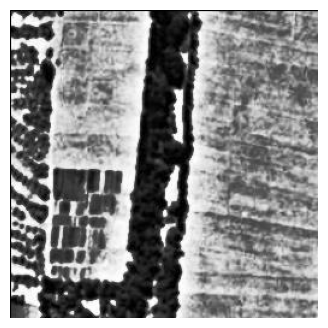

/content/DeployModelOnImages/images_for_detection/H1982_13858_jpg.rf.e4f9e61909db107ba410957fbc52e795.jpg


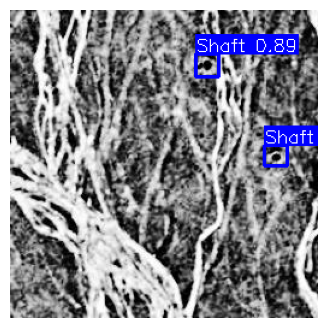

/content/DeployModelOnImages/images_for_detection/H1982_12130_jpg.rf.a45b823d20f06269648f51a4abcfa009.jpg


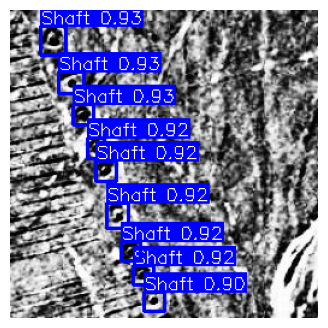

/content/DeployModelOnImages/images_for_detection/H1982_4108_jpg.rf.6b9cd7ae4045e9e7e39c9cd88e78f315.jpg


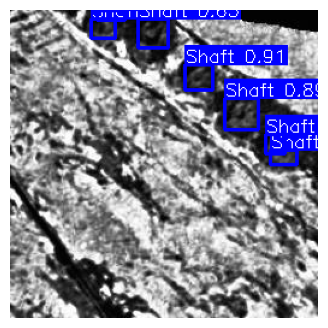

/content/DeployModelOnImages/images_for_detection/H1982_16812_jpg.rf.03fa110b893621bd92b6dad79356916b.jpg


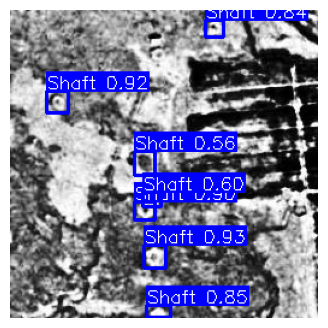

/content/DeployModelOnImages/images_for_detection/H1982_15431_jpg.rf.f60dee60ec61215ba3ac84ee6b7652a7.jpg


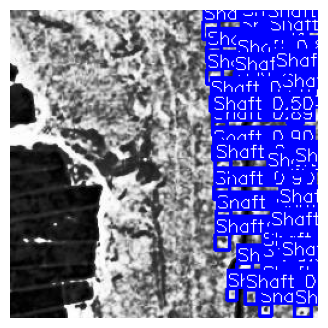

/content/DeployModelOnImages/images_for_detection/H1982_11482_jpg.rf.5cf1e896927e65d37355b413c4a76e78.jpg


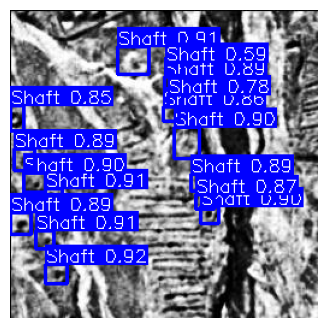

/content/DeployModelOnImages/images_for_detection/H1982_4110_jpg.rf.455e4caf939efb8bff83c4269fa892f4.jpg


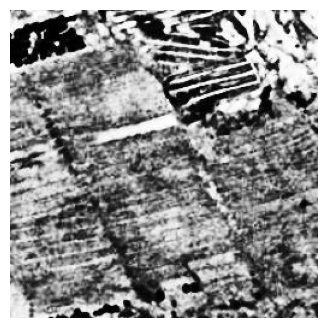

/content/DeployModelOnImages/images_for_detection/H1982_1693_jpg.rf.f9676d8c6651de23c6b32452c355ec1d.jpg


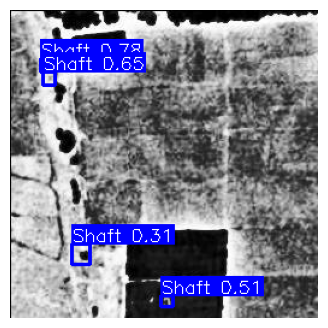

/content/DeployModelOnImages/images_for_detection/H1982_2817_jpg.rf.c1d94988b0a699f923f6d9667104fa0c.jpg


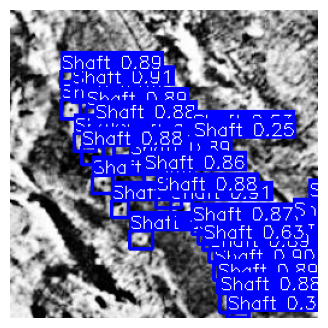

/content/DeployModelOnImages/images_for_detection/H1982_6817_jpg.rf.366ca73a005c698f5abf2c0f136c0f77.jpg


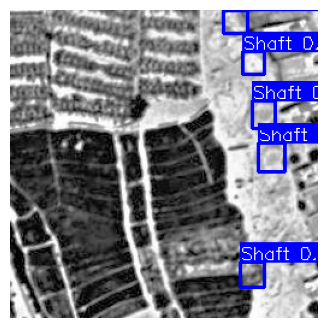

/content/DeployModelOnImages/images_for_detection/H1982_6346_jpg.rf.56e80dea70fb7927a82426e7686f6d07.jpg


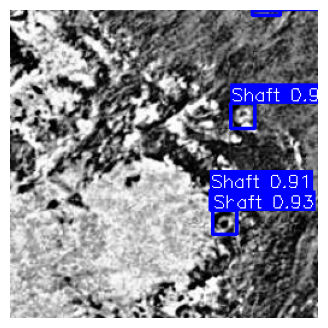

/content/DeployModelOnImages/images_for_detection/H1982_7391_jpg.rf.93b228335441aa999e0840d4f0ab2714.jpg


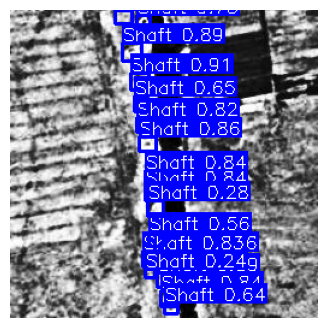

/content/DeployModelOnImages/images_for_detection/H1982_9695_jpg.rf.2e4ba8f6379d43638c6587c501fa4b0b.jpg


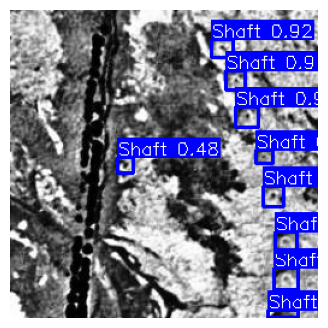

/content/DeployModelOnImages/images_for_detection/H1982_6342_jpg.rf.a4a09551095e7a1162eda65fff298585.jpg


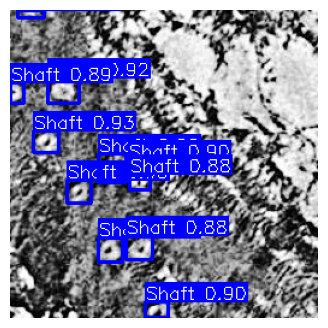

/content/DeployModelOnImages/images_for_detection/H1982_12710_jpg.rf.bebca5fd05ff6d947c7da0331a68fa13.jpg


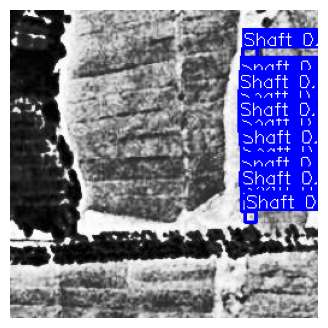

/content/DeployModelOnImages/images_for_detection/H1982_12141_jpg.rf.488491e4d73a5b17766cb9653db85010.jpg


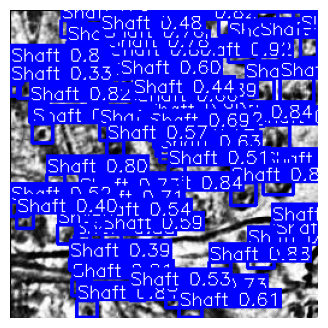

/content/DeployModelOnImages/images_for_detection/H1982_7468_jpg.rf.93081b322f04005f81b056cf9abe9c25.jpg


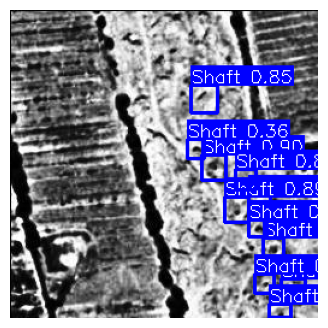

/content/DeployModelOnImages/images_for_detection/H1982_1692_jpg.rf.005e13f336b16cc263321923a57f8445.jpg


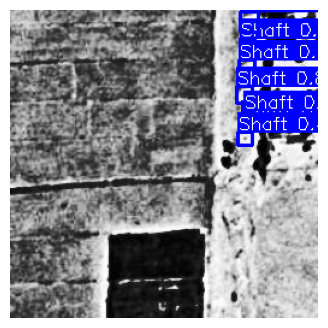

/content/DeployModelOnImages/images_for_detection/H1982_12815_jpg.rf.e2bd24cfaeb80473d8e9c85629ae39ea.jpg


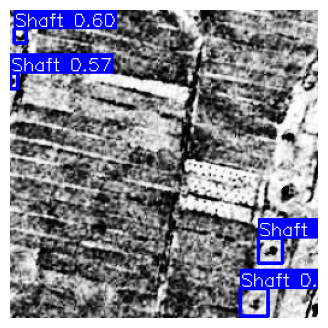

/content/DeployModelOnImages/images_for_detection/H1982_1696_jpg.rf.a7d1d58a3e515455e179e473b28eef9b.jpg


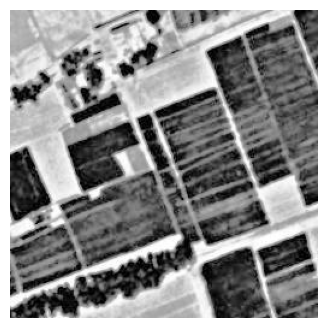

/content/DeployModelOnImages/images_for_detection/H1982_9687_jpg.rf.521d39c3b2fd195190eb0b9393194b0d.jpg


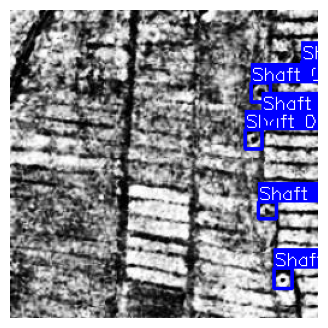

In [185]:
# For each image that we randomly selected earlier.
for img_name in image_paths:
  # Load the image.
  img = cv2.imread(img_name)
  if img is None:
    continue
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Get predictions for this image.
  img_preds = cleaned_predictions_df[cleaned_predictions_df["image_id"] == os.path.splitext(os.path.basename(img_name))[0]]

  for _, pred in img_preds.iterrows():
    # Get local bounding box and scale.
    h, w, _ = img.shape
    x1 = int(pred["top_bound_percentage"] * w)
    x2 = int(pred["bottom_bound_percentage"] * w)
    y1 = int(pred["left_bound_percentage"] * h)
    y2 = int(pred["right_bound_percentage"] * h)

    # Draw the rectangle.
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255), 2)

    # Draw a filled rectangle for text background.
    text = f"Shaft {pred['confidence']:.2f}"
    (text_w, text_h), _ = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    cv2.rectangle(img, (x1, y1 - text_h - 4), (x1 + text_w, y1), (0, 0, 255), -1)

    # Put the text on top of this filled rectangle.
    cv2.putText(img, text, (x1, y1 - 2), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

  # Display the image with annotations.
  print(img_name)
  plt.figure(figsize=(4, 4))
  plt.imshow(img)
  plt.axis("off")
  plt.show()


# Evaluation

We will now seek to access the accuracy of our model, in comparison with a manual evaluation.

---

We begin by loading in the manual annotations for the images selected previously, based on user input. We will add these annotations into a DataFrame. We will store and calculate the same information that we have for model predictions, namely:


*   image_id
*   top_bound_percentage
*   bottom_bound_percentage
*   left_bound_percentage
*   right_bound_percentage




In [186]:
# Load annotations.
annotations = '/content/DeployModelOnImages/manual_annotations'

annotation_paths = []
# For each image that we randomly selected earlier.
for image_path in image_paths:
  # Get the manual annotations for that image.
  base_name = os.path.basename(image_path)
  # Replace image extension with .txt
  annotation_name = os.path.splitext(base_name)[0] + '.txt'
  annotation_path = os.path.join(annotations, annotation_name)

  # Append the path to this manual annotation file to our list of annotations.
  if os.path.exists(annotation_path):
      annotation_paths.append(annotation_path)

# Create a dataframe storing the anotations.
dfs = []
for file in annotation_paths:
  # Check if the file is empty
  if os.stat(file).st_size == 0:
      continue  # skip empty files

  # Get the contents of this .txt.
  df = pd.read_csv(file, sep=" ", header=None)
  # Assign to columns of this DataFrame.
  df.columns = ["class", "x_center", "y_center", "width", "height"]
  # The name of this image is the last file name, without the appending .txt.
  df["image"] = os.path.basename(file).replace(".txt", "")

  # Append to the data frame.
  dfs.append(df)

# Merge the results.
all_annotations = pd.concat(dfs, ignore_index=True)

# Modify what is stored in our DataFrame to match model predictions.
results = []
# For each row (each prediction) in the combined csv.
for i, row in all_annotations.iterrows():
  image_id = row[5].split("_jpg.")[0]

  # Calculate the percentages.
  x_center = row[1]
  y_center = row[2]
  width = row[3]
  height = row[4]

  top_pct = x_center - width/2
  bottom_pct = x_center + width/2
  left_pct = y_center - height/2
  right_pct = y_center + height/2

  # Create WKT polygon (clockwise order).
  wkt_polygon = (
      f"POLYGON (({abs_left} {abs_top}, {abs_right} {abs_top}, {abs_right} {abs_bottom}, {abs_left} {abs_bottom}, {abs_left} {abs_top}))"
  )

  # Append this information to results.
  results.append({
      "image_id": image_id,
      "top_bound_percentage": top_pct,
      "bottom_bound_percentage": bottom_pct,
      "left_bound_percentage": left_pct,
      "right_bound_percentage": right_pct
    })

# Save results to a DataFrame.
annotations_df = pd.DataFrame(results)

/tmp/ipython-input-2470155760.py:41: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  image_id = row[5].split("_jpg.")[0]
/tmp/ipython-input-2470155760.py:44: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  x_center = row[1]
/tmp/ipython-input-2470155760.py:45: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  y_center = row[2]
/tmp/ipython-input-2470155760.py:46: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In

Now we will simplify the DataFrame that stores our model predictions, in order to match the format of the above DataFrame for manual annotations.

In [187]:
# This is our DataFrame of model predictions.
for _, row in cleaned_predictions_df.iterrows():
  cleaned_predictions_df["image_id"] = cleaned_predictions_df["image_id"].str.split("_jpg.").str[0]

model_predictions_df = cleaned_predictions_df.drop(columns=["confidence", "global_left", "global_right", "global_top", "global_bottom", "wkt"])

Now that we have two DataFrames with information that can be compared, we will do so. We will again use IoU calculations, defined for a slightly different set of parameters. Our IoU threshold will be 0.5.

In [188]:
IOU_THRESHOLD_EVALUATION = 0.5

def compute_iou_rel(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interWidth = max(0, xB - xA)
    interHeight = max(0, yB - yA)
    interArea = interWidth * interHeight

    boxAArea = max(0, (boxA[2] - boxA[0])) * max(0, (boxA[3] - boxA[1]))
    boxBArea = max(0, (boxB[2] - boxB[0])) * max(0, (boxB[3] - boxB[1]))

    if boxAArea + boxBArea - interArea == 0:
        return 0.0

    return interArea / (boxAArea + boxBArea - interArea)

We will also need to define a short helper function that we can use to convert our DataFrames into 'Boxes'. These boxes will be the inputs to our compute_iou_rel function. They will have the following format: [x1, x2, y1, y2] where these values all represent relative coordinates. They will be expressed as numbers between 0-1 (percentages).

In [189]:
def row_to_box(row):
    return [
        row["left_bound_percentage"],
        row["top_bound_percentage"],
        row["right_bound_percentage"],
        row["bottom_bound_percentage"]
    ]

We will define one final helper function whose purpose is to evaluate the overlap between two DataFrames. It does this by computing the IoU (and accordingly the cost, 1 - IoU) of each possible pairing of manual annotations and model predictions, creating 'boxes' for these annotations and predictions in the process. It then utilizes Hungarian matching to optimally pair off these manual and model boxes. Finally, it checks the IoU of each optimal pairing and compares that result with the IOU_THRESHOLD. It returns the number of true positives, false positives, and false negatives for our model predictions, based on manual annotations.

In [190]:
def evaluate_image_rel(manual_df, model_df, iou_threshold=IOU_THRESHOLD_EVALUATION):
    manual = len(manual_df)
    model = len(model_df)

    if manual == 0 and model == 0:
        return {"TP": 0, "FP": 0, "FN": 0}

    manual_boxes = [row_to_box(r) for _, r in manual_df.iterrows()]
    model_boxes  = [row_to_box(r) for _, r in model_df.iterrows()]

    # TP / FN: GT-centric logic
    TP = 0
    matched_model = set()

    for i, box_manual in enumerate(manual_boxes):
        best_iou = 0
        best_j = None

        for j, box_model in enumerate(model_boxes):
            iou = compute_iou_rel(box_manual, box_model)
            if iou > best_iou:
                best_iou = iou
                best_j = j

        if best_iou >= iou_threshold:
            TP += 1
            matched_model.add(best_j)

    FN = manual - TP

    # FP: predictions with no GT match
    FP = 0
    for j, box_model in enumerate(model_boxes):
        best_iou = max(
            (compute_iou_rel(box_model, box_manual) for box_manual in manual_boxes),
            default=0
        )
        if best_iou < iou_threshold:
            FP += 1

    return {"TP": TP, "FP": FP, "FN": FN}

Now that we have established the above 3 helper functions, we can resume with evaluating our model's preformance in comparison with our manual annotations. We will call our function main helper function, evaluate_image_rel, for each image in annotations_df and model_predictions_df. We can identify each image by it's image_id. We will then add the statistics of true positives, false positives, and false negatives to a DataFrame which will record these results, alongside the image_id.

In [191]:
def run_evaluation_for_years(year):
  results = []
  # Get the image_ids of all manual annotations and model predictions.
  all_images = set(annotations_df["image_id"])

  # Filter images if necessary
  selected_images = []
  if (year == "HEXAGON"): # Filter for years 1974, 1982, and 1984
    selected_images = {x for x in all_images if (x[1:5] == "1974" or x[1:5] == "1982" or x[1:5] == "1984")}
  elif (year == "SkySat"): # Filter for 2019
    selected_images = {x for x in all_images if x[1:5] == "2019"}
  else: # Include all images
    selected_images = all_images

  # For each image, get the DataFrames that represent all manual annotations and model predictions.
  # Then call our helper function, evaluate_image_rel, to determine TP, FP, and FN (s) for this image.
  for img_id in selected_images:
      manual = annotations_df[annotations_df.image_id == img_id]
      model = model_predictions_df[model_predictions_df.image_id == img_id]

      metrics = evaluate_image_rel(manual, model)
      metrics["image_id"] = img_id
      results.append(metrics)

  df_eval = pd.DataFrame(results)
  return df_eval

Finally, we can compile the results of this evaluation in order to draw conclusions about the precision and recall of our model, alongside reporting the total number of true positives, false positives, and false negatives.

In [192]:
# Run evaluation without no filtering
df_eval = run_evaluation_for_years("all_years")

total_TP = df_eval["TP"].sum()
total_FP = df_eval["FP"].sum()
total_FN = df_eval["FN"].sum()

precision = total_TP / (total_TP + total_FP + 1e-9)
recall = total_TP / (total_TP + total_FN + 1e-9)

if (user_provided_year == 0):
  print("The following evaluation metrics are for images from 1974, 1982, 1984, and 2019.")
else:
  print("The following evaluation metrics are for images from " + str(user_provided_year) + ".")

print("Total True Positives: ", total_TP)
print("Total False Positives: ", total_FP)
print("Total False Negatives: ", total_FN)
print("Precision: ", precision)
print("Recall: ", recall)

# If user selected all years, then run evaluation on HEXAGON and SkySat samples, independently
if (user_provided_year == 0):
  # Run evaluation for HEXAGON images only
  df_eval = run_evaluation_for_years("HEXAGON")

  total_TP = df_eval["TP"].sum()
  total_FP = df_eval["FP"].sum()
  total_FN = df_eval["FN"].sum()

  precision = total_TP / (total_TP + total_FP + 1e-9)
  recall = total_TP / (total_TP + total_FN + 1e-9)

  print("\n")
  print("The following evaluation metrics are for images from 1970, 1982, and 1984 only (HEXAGON images).")
  print("Total True Positives: ", total_TP)
  print("Total False Positives: ", total_FP)
  print("Total False Negatives: ", total_FN)
  print("Precision: ", precision)
  print("Recall: ", recall)

  # Run evaluation for SkySat images only
  df_eval = run_evaluation_for_years("SkySat")

  total_TP = df_eval["TP"].sum()
  total_FP = df_eval["FP"].sum()
  total_FN = df_eval["FN"].sum()

  precision = total_TP / (total_TP + total_FP + 1e-9)
  recall = total_TP / (total_TP + total_FN + 1e-9)

  print("\n")
  print("The following evaluation metrics are for images from 2019 only (SkySat images).")
  print("Total True Positives: ", total_TP)
  print("Total False Positives: ", total_FP)
  print("Total False Negatives: ", total_FN)
  print("Precision: ", precision)
  print("Recall: ", recall)

The following evaluation metrics are for images from 1982.
Total True Positives:  925
Total False Positives:  171
Total False Negatives:  261
Precision:  0.8439781021890109
Recall:  0.77993254637371
